# Where Do Best Students Come From?

## Abstract

- The aim of the project is to determine what factors may maximize high school students academic performance and consequently the chances to be admitted by highly ranked colleges and universities. Good middle school background is certainly an important factor, but is it the only one? What determines a decent high school, what do they have in common? The answers to these questions may help us understand better the primary and secondary education, including the major problems existing there.
- For these purposes we introduce several datasets published by New York City on [NYC Open Data](https://data.cityofnewyork.us/browse?category=Education), which we merge together in order to carry out our analysis. The main object of our investigation is the SAT score (available for 2012), reported on the school level, and which is a standardized test widely used in college admissions in the United States. Moreover, in these datasets there are a number of characteristics of those schools, which may help explaining the average performance of its graduates. The results of the analysis of the combined datasets might be quite representative, considering the fact that in New York City there is the largest public school system in the United States, where more than one million students are taught in 1,200 separate public schools.
- At the end of our analysis we conclude by constructing a portrayal of a typical high school student, who is likely to be successful academically, as measured by the SAT score. Such a student is **surrounded with Asian cultural environment (maybe tiger-parented), has fluent English, feels himself safe and not bullied, highly motivated to study beyond standardized high-school program, is placed in a school, where teachers are well-paid and students are rather drawn all over the city and has good basics obtained through middle school and earlier**. At the same time, we claim that SAT scores is not a good predictor of the subsequent students' success, but rather reflects the pure ability to solve fast within a certain time frame and can only partially describe students full potential. Moreover, the distributions of the SAT scores among schools is indicative of large **disparities related to socio-cultural differences and wealth/income, having a high detrimental effect to our society**.

## Intial Data Preparation

We have a number of datasets from NYC Open Data, which may be used to explore various characteristics of schools in this city. As long as SAT scores are available for 2012, all the other data cover roughly the same period. Overall, we have 8 distinct datasets, which we want to merge together based on schools codes. The list of datasets is presented below:
- [2010 AP (College Board) School Level Results](https://data.cityofnewyork.us/Education/2010-AP-College-Board-School-Level-Results/itfs-ms3e)
- [2010-2011 Class Size - School-level detail](https://data.cityofnewyork.us/Education/2010-2011-Class-Size-School-level-detail/urz7-pzb3)
- [2006 - 2012 School Demographics and Accountability Snapshot](https://data.cityofnewyork.us/Education/2006-2012-School-Demographics-and-Accountability-S/ihfw-zy9j)
- [2005-2010 Graduation Outcomes - School Level](https://data.cityofnewyork.us/Education/2005-2010-Graduation-Outcomes-School-Level/vh2h-md7a)
- [2010 - 2011 School Attendance and Enrollment Statistics by District](https://data.cityofnewyork.us/Education/2010-2011-School-Attendance-and-Enrollment-Statist/7z8d-msnt)
- [2012 SAT Results](https://data.cityofnewyork.us/Education/2012-SAT-Results/f9bf-2cp4)
- [2014 - 2015 DOE High School Directory](https://data.cityofnewyork.us/Education/2014-2015-DOE-High-School-Directory/n3p6-zve2)
- [2011 NYC School Survey](https://data.cityofnewyork.us/Education/2014-2015-DOE-High-School-Directory/n3p6-zve2)

Let's start with data donwloading and preparing school codes for merging.

In [1]:
import pandas as pd
import numpy as np
import re

# set the list of file names for downloading
data_files = [
    "2010__AP__College_Board__School_Level_Results.csv",
    "2010-2011_Class_Size_-_School-level_detail.csv",
    "2006_-_2012_School_Demographics_and_Accountability_Snapshot.csv",
    "2005-2010_Graduation_Outcomes_-_School_Level.csv",
    "2012_SAT_Results.csv",
    'Archived_DOE_High_School_Directory_2014-2015.csv'
]

# create dictionary with downloaded datasets
data = {}

for f in data_files:
    d = pd.read_csv("/Users/mac/downloads/{0}".format(f))
    d.to_csv("Projects_data/{0}".format(f))
    data[f.replace(".csv", "")] = d

In [2]:
# download additional data on attendance and surveys of students, parents and teachers
School_Attendance_and_Enrollment = pd.read_csv("/Users/mac/downloads/2010_-_2011_School_Attendance_and_Enrollment_Statistics_by_District.csv")
School_Attendance_and_Enrollment.to_csv("Projects_data/2010_-_2011_School_Attendance_and_Enrollment_Statistics_by_District.csv")
School_Attendance_and_Enrollment['CSD'] = School_Attendance_and_Enrollment.index + 1

pupil_teacher_ratio = data["2010-2011_Class_Size_-_School-level_detail"][data["2010-2011_Class_Size_-_School-level_detail"]['SCHOOLWIDE PUPIL-TEACHER RATIO'].notna()]
data["2010-2011_Class_Size_-_School-level_detail"] = pd.merge(data["2010-2011_Class_Size_-_School-level_detail"], pupil_teacher_ratio[['SCHOOL CODE','SCHOOLWIDE PUPIL-TEACHER RATIO']], on='SCHOOL CODE', how='left')
data["2010-2011_Class_Size_-_School-level_detail"] = data["2010-2011_Class_Size_-_School-level_detail"].rename(columns={'SCHOOLWIDE PUPIL-TEACHER RATIO_y': 'Student-Teacher Ratio'})

all_survey = pd.read_csv("/Users/mac/downloads/masterfile11_gened_final.txt", delimiter="\t", encoding='windows-1252')
all_survey.to_csv("Projects_data/masterfile11_gened_final.csv")
d75_survey = pd.read_csv("/Users/mac/downloads/masterfile11_d75_final.txt", delimiter="\t", encoding='windows-1252')
all_survey.to_csv("Projects_data/masterfile11_d75_final.csv")
survey = pd.concat([all_survey, d75_survey], axis=0)

survey["DBN"] = survey["dbn"]

# create a list of survey topics to extract for further analysis
survey_fields = [
    "DBN", 
    "rr_s", 
    "rr_t", 
    "rr_p", 
    "N_s", 
    "N_t", 
    "N_p", 
    "saf_p_11", 
    "com_p_11", 
    "eng_p_11", 
    "aca_p_11", 
    "saf_t_11", 
    "com_t_11", 
    "eng_t_11", 
    "aca_t_11", 
    "saf_s_11", 
    "com_s_11", 
    "eng_s_11", 
    "aca_s_11", 
    "saf_tot_11", 
    "com_tot_11", 
    "eng_tot_11", 
    "aca_tot_11",
]

survey = survey.loc[:,survey_fields]
data["survey"] = survey

In [3]:
# make school codes comparable for further matching
data["Archived_DOE_High_School_Directory_2014-2015"]["DBN"] = data["Archived_DOE_High_School_Directory_2014-2015"]["dbn"]

def pad_csd(num):
    string_representation = str(num)
    if len(string_representation) > 1:
        return string_representation
    else:
        return "0" + string_representation
    
data["2010-2011_Class_Size_-_School-level_detail"]["padded_csd"] = data["2010-2011_Class_Size_-_School-level_detail"]["CSD"].apply(pad_csd)
data["2010-2011_Class_Size_-_School-level_detail"]["DBN"] = data["2010-2011_Class_Size_-_School-level_detail"]["padded_csd"] + data["2010-2011_Class_Size_-_School-level_detail"]["SCHOOL CODE"]

Next, we should also make SAT and AP scores numeric for further analysis and prepare schools' longitude and latitude columns to locate them on the New York City map.

In [4]:
# convert SAT subsections' scores into numeric values and calculate the total score
cols = ['SAT Math Avg. Score', 'SAT Critical Reading Avg. Score', 'SAT Writing Avg. Score']
for c in cols:
    data["2012_SAT_Results"][c] = pd.to_numeric(data["2012_SAT_Results"][c], errors="coerce")
data['2012_SAT_Results']['sat_score'] = data['2012_SAT_Results'][cols[0]] + data['2012_SAT_Results'][cols[1]] + data['2012_SAT_Results'][cols[2]]

# convert AP scores into numeric values
cols = ['AP Test Takers ', 'Total Exams Taken', 'Number of Exams with scores 3 4 or 5']
for col in cols:
    data["2010__AP__College_Board__School_Level_Results"][col] = pd.to_numeric(data["2010__AP__College_Board__School_Level_Results"][col], errors="coerce")

# create functions to extract latitude and longitude values out of rows and apply them
def find_lat(loc):
    coords = re.findall("\(.+, .+\)", loc)
    lat = coords[0].split(",")[0].replace("(", "")
    return lat

def find_lon(loc):
    coords = re.findall("\(.+, .+\)", loc)
    lon = coords[0].split(",")[1].replace(")", "").strip()
    return lon

data["Archived_DOE_High_School_Directory_2014-2015"]["lat"] = data["Archived_DOE_High_School_Directory_2014-2015"]["Location 1"].apply(find_lat)
data["Archived_DOE_High_School_Directory_2014-2015"]["lon"] = data["Archived_DOE_High_School_Directory_2014-2015"]["Location 1"].apply(find_lon)

data["Archived_DOE_High_School_Directory_2014-2015"]["lat"] = pd.to_numeric(data["Archived_DOE_High_School_Directory_2014-2015"]["lat"], errors="coerce")
data["Archived_DOE_High_School_Directory_2014-2015"]["lon"] = pd.to_numeric(data["Archived_DOE_High_School_Directory_2014-2015"]["lon"], errors="coerce")

In our further analysis we will consider only students of 9-12 grades who are enrolled in General Education program, as well as school demographics data for 2011-12 period. In addition, we also select only the 2006 total cohorts of students, who entered 9th grade in a given school in that year and graduated in 2010.

In [5]:
# choose only student from 9-12 grades enrolled in the general education program
class_size = data["2010-2011_Class_Size_-_School-level_detail"]
class_size = class_size[class_size["GRADE "] == "09-12"]
class_size = class_size[class_size["PROGRAM TYPE"] == "GEN ED"]

# aggregate values in Class Size file by school codes
class_size = class_size.groupby("DBN").agg(np.mean)
class_size.reset_index(inplace=True)
data["2010-2011_Class_Size_-_School-level_detail"] = class_size

# choose only values for 2011 and 2012 in School Demographics file
data["2006_-_2012_School_Demographics_and_Accountability_Snapshot"] = data["2006_-_2012_School_Demographics_and_Accountability_Snapshot"][data["2006_-_2012_School_Demographics_and_Accountability_Snapshot"]["schoolyear"] == 20112012]

# choose only the most recent cohort of students
data["2005-2010_Graduation_Outcomes_-_School_Level"] = data["2005-2010_Graduation_Outcomes_-_School_Level"][data["2005-2010_Graduation_Outcomes_-_School_Level"]["Cohort"] == "2006"]
data["2005-2010_Graduation_Outcomes_-_School_Level"] = data["2005-2010_Graduation_Outcomes_-_School_Level"][data["2005-2010_Graduation_Outcomes_-_School_Level"]["Demographic"] == "Total Cohort"]

When all datasets are prepared we combine them together into a single one for further analysis.

In [6]:
# create a merged dataset
combined = data["2012_SAT_Results"]
combined = combined.merge(data["2010__AP__College_Board__School_Level_Results"], on="DBN", how="left").copy()
combined = combined.merge(data["2005-2010_Graduation_Outcomes_-_School_Level"], on="DBN", how="left").copy()

# create list of datasets for merging and loop through it
to_merge = ["2010-2011_Class_Size_-_School-level_detail", "2006_-_2012_School_Demographics_and_Accountability_Snapshot", "survey", "Archived_DOE_High_School_Directory_2014-2015"]
for m in to_merge:
    combined = combined.merge(data[m], on="DBN", how="inner").copy()
    
combined = combined.merge(School_Attendance_and_Enrollment, on="CSD", how="left").copy()

# create function to extract school district codes
def get_first_two_chars(dbn):
    return dbn[0:2]
combined["school_dist"] = combined["DBN"].apply(get_first_two_chars)

print('Number of rows and columns in combined dataset:', combined.shape)

Number of rows and columns in combined dataset: (363, 163)


After compiling the dataset, let's check the variable of our major interest - the distribution of SAT scores among New York schools.

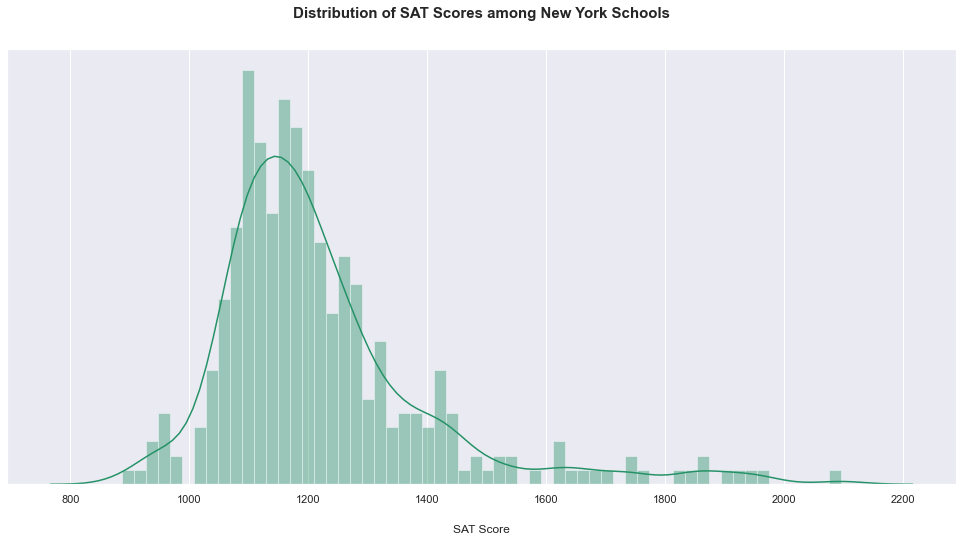

In [7]:
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns

fig = plt.figure(figsize=(17,8))

sns.set(palette='summer')
sns.distplot(combined['sat_score'], bins=60, hist=True)

plt.title("Distribution of SAT Scores among New York Schools", 
          fontweight="bold", fontsize=15, y=1.06)
plt.xlabel('SAT Score', labelpad=20)
plt.yticks([])
plt.show()

The histogram tells us that the disribution of SAT scores is unimodal and skewed to the right. Not that many schools on average perform over the 1600 threshold.

## Environment Safety Perception Might Be Quite Important to Perform Well on SAT

Let's start our analysis with exploring correlations between major variables. In NYC school survey there are data on teachers, students and parents perception of safety, communication, engagement and academic expectations. Investigating their relationship with SAT scores may help us understanding better the determinants of school performance.

In [8]:
# create correlation matrix
correlations = combined.corr()
survey_fields.remove("DBN")
print('Variables correlation with the SAT score:\n\n',correlations["sat_score"])

Variables correlation with the SAT score:

 SAT Critical Reading Avg. Score    0.986820
SAT Math Avg. Score                0.972643
SAT Writing Avg. Score             0.987771
sat_score                          1.000000
AP Test Takers                     0.542641
                                     ...   
total_students                     0.411785
number_programs                    0.118241
lat                               -0.124166
lon                               -0.137163
YTD % Attendance (Avg)             0.271784
Name: sat_score, Length: 74, dtype: float64


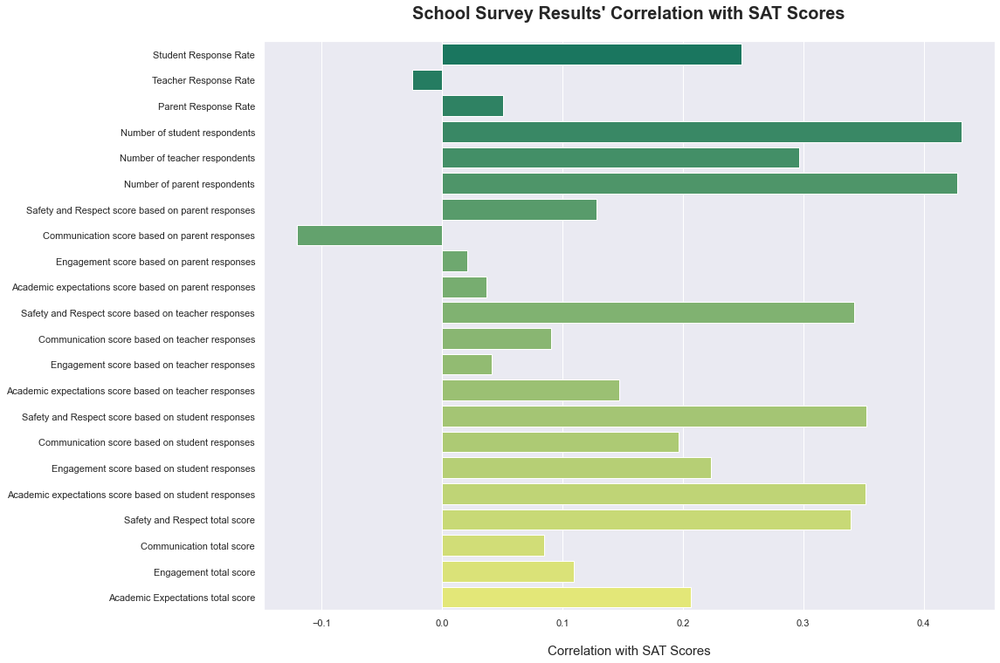

In [9]:
fig = plt.figure(figsize=(15,12))

sns.barplot(y=survey_fields, x=correlations["sat_score"][survey_fields], palette='summer')

# list of variables to show on the graph with their respective correlations
y_ticks = [
    'Student Response Rate',
    'Teacher Response Rate',
    'Parent Response Rate',
    'Number of student respondents',
    'Number of teacher respondents',
    'Number of parent respondents',
    'Safety and Respect score based on parent responses',
    'Communication score based on parent responses',
    'Engagement score based on parent responses',
    'Academic expectations score based on parent responses',
    'Safety and Respect score based on teacher responses',
    'Communication score based on teacher responses',
    'Engagement score based on teacher responses',
    'Academic expectations score based on teacher responses',
    'Safety and Respect score based on student responses',
    'Communication score based on student responses',
    'Engagement score based on student responses',
    'Academic expectations score based on student responses',
    'Safety and Respect total score',
    'Communication total score',
    'Engagement total score',
    'Academic Expectations total score',
]

plt.title("School Survey Results' Correlation with SAT Scores" , 
          fontweight="bold", fontsize = 20, y=1.03)
locs, labels=plt.yticks()
plt.yticks(locs, y_ticks)
plt.xlabel('Correlation with SAT Scores',labelpad=20, fontsize=15)
plt.show()

There is a significant positive correlation between the number of survey responses (closely related to the total number of students in a school) made and SAT scores - the number of students in the [best public schools](https://www.schooldigger.com/go/NY/schoolrank.aspx?level=3) is usually over 1000, while the average number of students per school in New York City is around 500. This result is not surprising, as many of such schools are of magnet type, i.e. they may draw students outside of defined school zones and provide specialised curriculum, while many parents all over the city, quite naturally, wish better future for their children and try to place them in such schools.

We may also observe that students' response rate is positively correlated with SAT score, which might be explained by self-selection - students confident in their test results can also be more responsive to surveys. In addition, teachers' and students' safety and respect perception of environment seems to be related to higher SAT scores, which is less the case for parents, who are not the direct participants of the studying process. Therefore, safety or, say, the general well-being of surroundings matters - the total score for this indicator has the highest correlation among other totals, indicating its overall (i.e. among all survey participants) higher significance. Finally, it is quite noteworthy that academic expectations of students are correlated with SAT scores more, than analogous indicators for teachers or parents. This theoretically may mean that students are able to assess their abilities more precisely than even teachers, who teach them.

Knowing that  among the totals considered Safety and Respect total score correlates the most with the SAT scores of the corresponding schools, let's explore their relationship in greater detail by plotting a scatter plot.

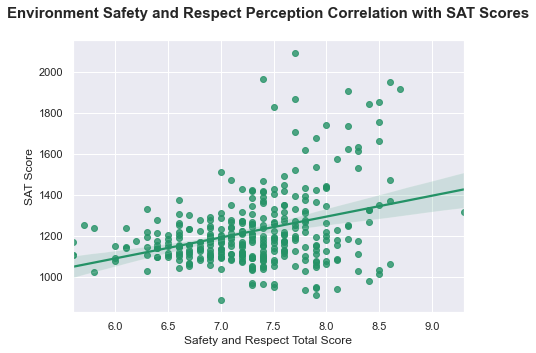

In [10]:
fig = plt.figure(figsize=(7,5))
combined = combined.rename(columns={'saf_tot_11':'Safety and Respect Total Score', 'sat_score':'SAT Score'})

sns.regplot(x='Safety and Respect Total Score', y='SAT Score', data=combined)
plt.title("Environment Safety and Respect Perception Correlation with SAT Scores" , 
          fontweight="bold", fontsize = 15, y=1.06)

plt.show()

We can see, that there is some positive correlation between safety and SAT scores with the number of outliers in the upper-right corner. At the same time, there is also a group of schools with comparatively high safety level, but lower SAT scores - in the lower-right part of the plot. Nonetheless, it doesn't work the other way around - none of the schools with Safety and Respect total score lower than 6 has a SAT score higher than 1400. Presumably, this may be explained by the fact that unsafe districts are usually populated by poor people with lower paid jobs - generally speaking, it is quite rare to encounter schools with well-performing students there. 

To check this conjecture, let's inspect how the Safety and Respect Score is distributed in New York City by school districts.

/Users/mac/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:18: MatplotlibDeprecationWarning: 
The dedent function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use inspect.cleandoc instead.


http://server.arcgisonline.com/ArcGIS/rest/services/World_Topo_Map/MapServer/export?bbox=913122.7552658002,120102.74445561501,1067090.3211205194,272872.4941039085&bboxSR=2263&imageSR=2263&size=1500,1488&dpi=96&format=png32&transparent=true&f=image


/Users/mac/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:23: MatplotlibDeprecationWarning: 
The dedent function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use inspect.cleandoc instead.
/Users/mac/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:24: MatplotlibDeprecationWarning: 
The dedent function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use inspect.cleandoc instead.
/Users/mac/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:40: MatplotlibDeprecationWarning: 
The dedent function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use inspect.cleandoc instead.


http://server.arcgisonline.com/ArcGIS/rest/services/World_Topo_Map/MapServer/export?bbox=913122.7552658002,120102.74445561501,1067090.3211205194,272872.4941039085&bboxSR=2263&imageSR=2263&size=1500,1488&dpi=96&format=png32&transparent=true&f=image


/Users/mac/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:45: MatplotlibDeprecationWarning: 
The dedent function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use inspect.cleandoc instead.
/Users/mac/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:47: MatplotlibDeprecationWarning: 
The dedent function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use inspect.cleandoc instead.


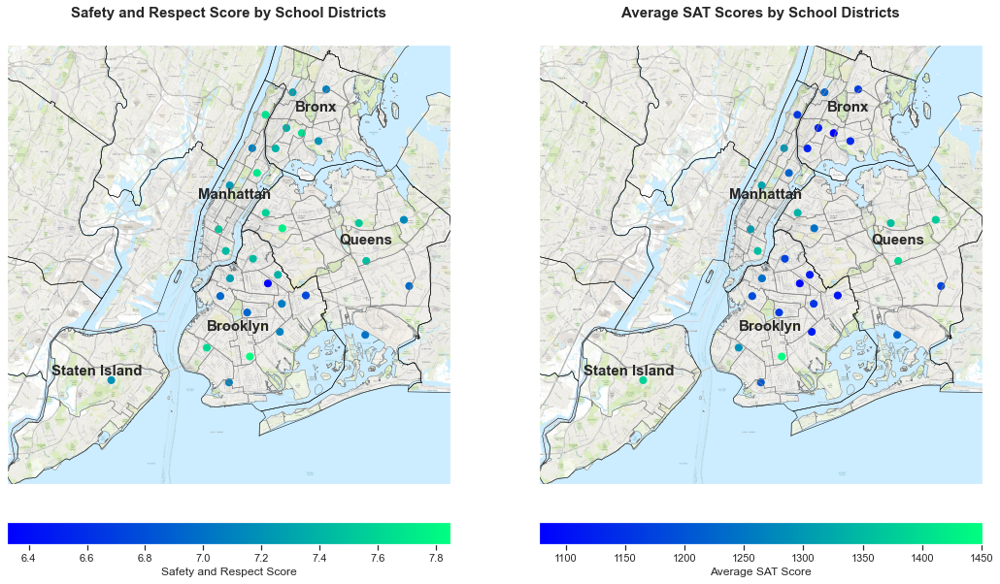

In [11]:
from mpl_toolkits.basemap import Basemap

# aggregated data by school districts for mapping
combined_grouped = combined.groupby('school_dist').agg(np.mean)
combined_grouped.reset_index(inplace=True)

fig = plt.figure(figsize = (18, 18))

longitudes = list(combined_grouped['lon'])
latitudes = list(combined_grouped['lat'])

ax = fig.add_subplot(121)
ax.set_title("Safety and Respect Score by School Districts", fontweight="bold", fontsize = 15, y=1.05)
# set map boundaries
map = Basemap(llcrnrlat=40.496044, 
    urcrnrlat=40.915256, 
    llcrnrlon=-74.255735, 
    urcrnrlon=-73.700272, epsg=2263)

# set map background and locate school districts with their mean values
map.arcgisimage(service='World_Topo_Map', xpixels = 1500, verbose= True)
map.scatter(longitudes, latitudes, s=50, zorder=2, latlon=True, c=combined_grouped["Safety and Respect Total Score"], cmap='winter')
map.readshapefile('/Users/mac/downloads/geo_export_9b152510-8274-4e63-bfa9-0e6b8d75f118', name='NYC_districts', color='grey')
map.drawcounties(linewidth=0.5, linestyle='solid', color='k', antialiased=1, facecolor='none', ax=None, zorder=2, drawbounds=False)

# set borough names
plt.annotate('Brooklyn', xy=(0.45, 0.35), xycoords='axes fraction', fontweight="bold",fontsize = 15)
plt.annotate('Queens', xy=(0.75, 0.55), xycoords='axes fraction', fontweight="bold",fontsize = 15)
plt.annotate('Bronx', xy=(0.65, 0.85), xycoords='axes fraction', fontweight="bold",fontsize = 15)
plt.annotate('Manhattan', xy=(0.43, 0.65), xycoords='axes fraction', fontweight="bold",fontsize = 15)
plt.annotate('Staten Island', xy=(0.1, 0.25), xycoords='axes fraction', fontweight="bold",fontsize = 15)
plt.colorbar(label='Safety and Respect Score',fraction=0.046, pad=0.04, orientation='horizontal')

# the same procedure is done for the second map
ax = fig.add_subplot(122)
ax.set_title('Average SAT Scores by School Districts', fontweight="bold", fontsize = 15, y=1.05)
map = Basemap(llcrnrlat=40.496044, 
    urcrnrlat=40.915256, 
    llcrnrlon=-74.255735, 
    urcrnrlon=-73.700272, epsg=2263)
#http://server.arcgisonline.com/arcgis/rest/services

map.arcgisimage(service='World_Topo_Map', xpixels = 1500, verbose= True)
map.scatter(longitudes, latitudes, s=50, zorder=2, latlon=True, c=combined_grouped["SAT Score"], cmap='winter')
map.readshapefile('/Users/mac/downloads/geo_export_9b152510-8274-4e63-bfa9-0e6b8d75f118', name='NYC_districts', color='grey')

map.drawcounties(linewidth=0.5, linestyle='solid', color='k', antialiased=1, facecolor='none', ax=None, zorder=2, drawbounds=False)
plt.annotate('Brooklyn', xy=(0.45, 0.35), xycoords='axes fraction', fontweight="bold",fontsize = 15)
plt.annotate('Queens', xy=(0.75, 0.55), xycoords='axes fraction', fontweight="bold",fontsize = 15)
plt.annotate('Bronx', xy=(0.65, 0.85), xycoords='axes fraction', fontweight="bold",fontsize = 15)
plt.annotate('Manhattan', xy=(0.43, 0.65), xycoords='axes fraction', fontweight="bold",fontsize = 15)
plt.annotate('Staten Island', xy=(0.1, 0.25), xycoords='axes fraction', fontweight="bold",fontsize = 15)
plt.colorbar(label='Average SAT Score',fraction=0.046, pad=0.04, orientation='horizontal')

plt.show()

From the above plots we may note that overall Brooklyn school districts are considered as the least safe, followed by Bronx and Queens in this respect. Nonetheless, there are also two safest school districts in Brooklyn, indicating that this measure is not homogeneous within boroughs. On the other hand, the best performing school district in terms of SAT scores is located in Brooklyn, closely followed by another districts in Staten Island and Queens. Overall, these maps show us some divergence in the geographical distribution of these two variables, even though the overall correlation is high. It is possible to assume then that richer districts are often safer, have higher level of education-related funding and henceforth the best-performing schools are located there - i.e. the correlation between the level of life and academic performance should be even more ubiquitous, as compared to pure safety perception.

## Income Effect Might Have Higher Explanatory Power for SAT Scores Than Wealth Effect

To confirm or reject the above-mentioned proposition, we may actually explore in greater detail the average price per square foot over New York City, as one of the possible proxies for wealth distribution on the neighborhood level. For that purpose we use 2012 property annual sales data from [NYC Department of Finance](https://www1.nyc.gov/site/finance/taxes/property-annualized-sales-update.page). To make our analysis more representative and accurate, we get rid of unrealistically small and extremely large values for sales prices and footage, so that to take into account only average properties. In addition, we supply the map with the data on Adjusted Gross Income per Tax Return reported by the [Internal Revenue Service](https://www.irs.gov/statistics/soi-tax-stats-individual-income-tax-statistics-2012-zip-code-data-soi) on the ZIP code level and defined as gross individual income reported by tax payers, adjusted for education expenses, alimony payments and contributions to a retirement account.

In [12]:
# download property data
manhattan = pd.read_excel('https://www1.nyc.gov/assets/finance/downloads/pdf/rolling_sales/annualized-sales/2012/2012_manhattan.xls')
bronx = pd.read_excel('https://www1.nyc.gov/assets/finance/downloads/pdf/rolling_sales/annualized-sales/2012/2012_bronx.xls')
brooklyn = pd.read_excel('https://www1.nyc.gov/assets/finance/downloads/pdf/rolling_sales/annualized-sales/2012/2012_brooklyn.xls')
staten_island = pd.read_excel('https://www1.nyc.gov/assets/finance/downloads/pdf/rolling_sales/annualized-sales/2012/2012_statenisland.xls')
queens = pd.read_excel('https://www1.nyc.gov/assets/finance/downloads/pdf/rolling_sales/annualized-sales/2012/2012_queens.xls')

# merge data and get rid of outliers and unrealistic values
property_data = pd.concat([manhattan, bronx, brooklyn, queens, staten_island], axis=0)
property_data = property_data.iloc[:,[10,14,19]].dropna()
property_data.columns = ['ZIP Code','Land Square Feet','Sale price']
property_data.to_csv('Projects_data/NYC_property_data')
property_data = property_data[(property_data['ZIP Code'] != 'ZIP CODE\n') & (property_data['ZIP Code'] != 0)]
property_data = property_data.astype(int)
property_data = property_data[(property_data['Sale price']>50000) & (property_data['Sale price']<5000000)]
property_data = property_data[(property_data['Land Square Feet']>500) & (property_data['Land Square Feet']<5000)]
property_data['Price Per Square Foot'] = property_data['Sale price']/property_data['Land Square Feet']
property_data_aggregated = round(property_data.groupby('ZIP Code').agg(np.mean),2)
property_data_aggregated.reset_index(inplace=True)

# download income data
adjusted_gross_income = pd.read_excel('https://www.irs.gov/pub/irs-soi/12zp33ny.xls')
adjusted_gross_income = adjusted_gross_income.iloc[5:,[0,1,2,9]]
adjusted_gross_income.columns = ['ZIP Code','Size of adjusted gross income','Number of Returns (AGI)','Adjusted Gross Income']
adjusted_gross_income.to_csv('Projects_data/NYC_adjusted_gross_income')
adjusted_gross_income['Size of adjusted gross income'] = adjusted_gross_income['Size of adjusted gross income'].fillna('Total')
adjusted_gross_income = adjusted_gross_income[(adjusted_gross_income['Number of Returns (AGI)']>0) & (adjusted_gross_income['Adjusted Gross Income']>0)]
adjusted_gross_income['Adjusted Gross Income per Tax Return'] = round(adjusted_gross_income['Adjusted Gross Income'].astype(int)*1000/adjusted_gross_income['Number of Returns (AGI)'].astype(int),2)
adjusted_gross_income = adjusted_gross_income[adjusted_gross_income['Size of adjusted gross income']=='Total'].iloc[:,[0,-1]]
combined = pd.merge(combined, adjusted_gross_income, left_on='zip', right_on='ZIP Code', how='left')

# ZIP Code Definitions of New York City Neighborhoods (NYC Department of Health) webfile was manually  
# adjusted to make a correspondence between ZIP codes and neighborhoods for mapping
NYC_zips_dist = pd.read_excel('/Users/mac/downloads/NewYorkZips.xlsx')
NYC_zips_dist.to_csv('Projects_data/NYC_zips_dist')
property_data_merged = pd.merge(NYC_zips_dist, property_data_aggregated, on='ZIP Code', how='left')
combined = pd.merge(combined, property_data_aggregated, left_on='zip', right_on='ZIP Code', how='left')

# dowload locations of all ZIP codes in New York
import json
from urllib.request import urlopen
with urlopen('https://raw.githubusercontent.com/gdobler/nycep/master/d3/data/nyc-zip-code.json') as f:
    geodata = json.load(f)

# create list with all New York ZIP codes for complete mapping
zips = []
GEO_zips = pd.DataFrame()  
for i in geodata['features']:
    for j in i['properties']:
        zips.append(i['properties']['ZIP'])

# create dataset for mapping
zips = pd.DataFrame(zips).astype(int)
zips.columns = ['ZIP Code']
GEO_zips = zips.drop_duplicates()
property_data_for_graph = pd.merge(GEO_zips, property_data_merged, on='ZIP Code', how='left')
property_data_for_graph = pd.merge(property_data_for_graph, adjusted_gross_income, on='ZIP Code', how='left')

In [13]:
import plotly.express as px

# set variable to show on the map
property_data_for_graph['Neighborhood'] = property_data_for_graph['Neighborhood'].fillna('No data')
property_data_for_graph['color'] = property_data_for_graph['Price Per Square Foot'].fillna(-500) # set minimal color for colorscale
property_data_for_graph['Avg. Price Per Square Foot'] = property_data_for_graph['Price Per Square Foot'].fillna('No data')
property_data_for_graph['Gross Income per Tax Return'] = property_data_for_graph['Adjusted Gross Income per Tax Return'].fillna('No data')
combined['School Average SAT Score'] = combined['SAT Score'].fillna('No data')
combined['SAT Critical Reading Score'] = combined['SAT Critical Reading Avg. Score'].fillna('No data')
combined['SAT Math Reading Score'] = combined['SAT Math Avg. Score'].fillna('No data')
combined['SAT Writing Reading Score'] = combined['SAT Writing Avg. Score'].fillna('No data')
combined['Borough'] = combined['boro']
combined['Total Enrollment'] = combined['total_enrollment']
combined['marker_size'] = combined['SAT Score'].fillna(800)/100 # adjust sizes of circles mapping schools
combined['color'] = combined['SAT Score']+550 # adjust school colors for the coloscale based on SAT scores

# plot the map
fig = px.choropleth_mapbox(property_data_for_graph, geojson=geodata, color="color",
                           color_continuous_scale="Viridis", 
                           locations="ZIP Code", featureidkey="properties.ZIP", 
                           center={"lat": 40.7128, "lon": -74.0060}, opacity=0.8, 
                           mapbox_style="carto-positron", zoom=9.5, hover_name="Neighborhood",
                           hover_data={'ZIP Code':False,'Avg. Price Per Square Foot':True,
                           'Price Per Square Foot':False,'color':False,'Gross Income per Tax Return':True})

# locate schools on the map
fig2 = px.scatter_mapbox(combined, lat="lat", lon="lon", color="color", hover_name='SCHOOL NAME',
       hover_data={'lat':False,'lon':False,'color':False,'Borough':True,'Total Enrollment':True,
       'School Average SAT Score':True, 'SAT Critical Reading Score':True,'SAT Math Reading Score':True,
       'SAT Writing Reading Score':True})

# adjust map parameters
fig2.update_traces(marker=dict(size=combined['marker_size'], opacity=0.75, symbol='circle'))
fig.add_trace(fig2.data[0]) # adds the line trace to the first figure
fig.update_layout(margin={"r":0,"t":30,"l":0,"b":0}, title_text='Real Estate Prices vs SAT Scores',
        coloraxis_colorbar=dict(title="Price Per Square Foot", tickvals=[-500, 0, 500, 1000, 1500, 2000, 2500],
        ticktext=['No data', 0, 500, 1000, 1500, 2000, 2500])) # rename colorscale

fig.show()

From the map above we may see that the most expensive properties in New York City are concentrated in Manhattan and some adjacent areas to the south (i.e. Northern Brooklyn and Western Queens) - the difference with the rest of the New York City area is striking. Nonetheless, there are only five best-performing schools in terms of SAT scores in this vicinity (including the second-best Stuyvesant High School), while other similar schools are rather dispersed in far less expensive neighborhoods. Therefore, with these results we cannot ascertain a positive relationship between level of life, as measured by real estate prices, and school academic performance.

Nonetheless, it is possible to assume that real estate prices are stipulated to a higher extent by historical factors, and there could be many people with average level of income, who just inherited their properties from their ancestors. Henceforth, other measures of the level of life might also be considered. Let's resort to such alternative proxy - median household income on districts level. The corresponding data are available on [Citizens' Committee for Children of New York](https://data.cccnewyork.org/data/table/66/median-incomes#66/107/11/a/a) in the analysis-friendly format, being primarily based on the American Community Survey of the U.S. Census Bureau.

In [14]:
income = pd.read_excel("/Users/mac/downloads/Median Incomes.xls")
rent = pd.read_excel("/Users/mac/downloads/Median Monthly Rent.xls")
income = income[(income['TimeFrame']==2012) & (income['Household Type']=='All Households')]
income['Household Median Income'] = round(income['Data'],2)
rent = rent[rent['TimeFrame']==2012]
rent = round(rent.rename(columns={'Data':'Median Monthly Rent'}),2)
income_rent = pd.merge(income, rent, on="Location", how="left")
income_rent = income_rent.rename(columns={'Location':'Community District'})
income_rent.to_csv('Projects_data/income_rent')

# download locations of all community districts
with urlopen('https://raw.githubusercontent.com/dwillis/nyc-maps/master/community_districts.geojson') as f:
    community_districts = json.load(f)

# create list with all New York community districts for complete mapping
fips = []
GEO_fips = pd.DataFrame()  
for i in community_districts['features']:
    for j in i['properties']:
        fips.append(i['properties']['BoroCD'])

# create dataset for mapping
fips = pd.DataFrame(fips).astype(int)
fips.columns = ['Fips_x']
GEO_fips = fips.drop_duplicates()
income_data_for_graph = pd.merge(GEO_fips, income_rent, on='Fips_x', how='left')

In [15]:
# apply the same procedure as for the previous map
combined['color'] = combined['SAT Score']*55
income_data_for_graph['color'] = income_data_for_graph['Data'].fillna(-25000)
income_data_for_graph['Household Median Income'] = income_data_for_graph['Household Median Income'].fillna('No data')
income_data_for_graph['Median Monthly Rent'] = income_data_for_graph['Median Monthly Rent'].fillna('No data')
income_data_for_graph['Community District'] = income_data_for_graph['Community District'].fillna('No data')

fig = px.choropleth_mapbox(income_data_for_graph, geojson=community_districts, color="color",
                           color_continuous_scale="Viridis",
                           locations="Fips_x", featureidkey="properties.BoroCD", center={"lat": 40.7128, "lon": -74.0060},
                           opacity=0.8, mapbox_style="carto-positron", zoom=9.5, hover_name="Community District",
                           hover_data={'Fips_x':False,'color':False,'Household Median Income':True,'Median Monthly Rent':True})

fig2 = px.scatter_mapbox(combined, lat="lat", lon="lon", color="color", hover_name='SCHOOL NAME', 
                         hover_data={'lat':False,'lon':False,'color':False,'Borough':True,'Total Enrollment':True,
                         'SAT Score':True, 'SAT Critical Reading Score':True,'SAT Math Reading Score':True,
                         'SAT Writing Reading Score':True})

fig2.update_traces(marker=dict(size=combined['marker_size'], opacity=0.75, symbol='circle'))

fig.add_trace(fig2.data[0]) # adds the line trace to the first figure

fig.update_layout(margin={"r":0,"t":30,"l":0,"b":0}, title_text='Household Median Income vs SAT Scores',
    coloraxis_colorbar=dict(title="Household Median Income", tickvals=[-20000, 0, 20000, 40000, 60000, 80000, 100000],
    ticktext=['No data', '0', '20k', '40k', '60k', '80k', '100k']))

fig.show()

The map shows us that the distribution of median household income among city areas is more homogeneous with Manhattan and Staten Island as the leaders in this respect. At the same time, there are well performing schools in poor districts - specifically in the northern part of Bronx we may observe two of the leading schools in terms of SAT scores. On balance, it seems possible to conclude that there is comparatively more evident relationship between household median income and schools' performance. Nonetheless, the overlap with the safety perception is not obvious. Moreover, households wealth and income characterize only students' accessibility to the resources necessary for studies, but the very quality of education and consequently higher SAT scores might presumably be explained more by school funding.

## School Funding Effect Might Be Overshadowed by Related Policies Aimed at Schools in Poor Districts

According to the financial policies related to public education more resources are directed to schools where poor students prevail. On the other hand, more qualified teachers require higher salaries and their level of competence might be directly related to students academic performance. Let's check the relationship between teachers' salaries, which is the main constituent of schools' funding, and schools' average SAT scores, and also take into account the percentage of those eligible for free or reduced price lunches - the last one is indicative of the share of student from low income families (after 2012 lunches became accessible for everyone in schools). For these purposes we use 2010-12 data from the [Federal Reserve Bank of New York](https://www.newyorkfed.org/data-and-statistics/data-visualization/nyc-school-spending#interactive/table), which provides with the figures on school funding on the school districts level - the years before the 2012 SAT results.

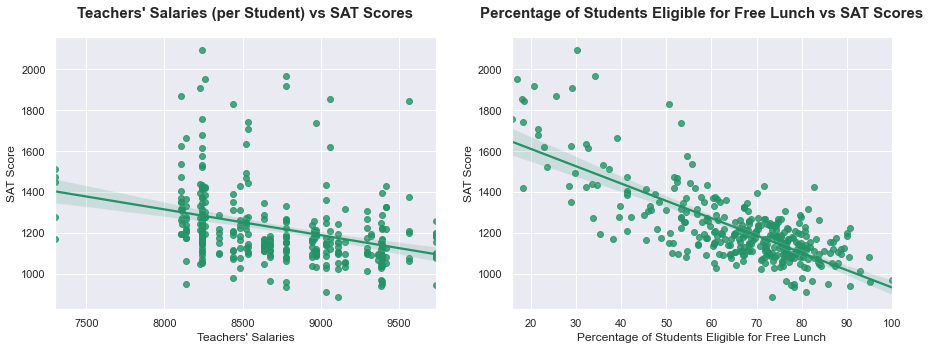

In [16]:
# download data on school funding on the school districts level
school_spending = pd.read_excel('https://www.newyorkfed.org/medialibrary/interactives/nyc-school-spending/nyc-school-spending/downloads/csd_expend.xlsx?v=1.0.0')
school_spending = school_spending[(school_spending['year']==2010) | (school_spending['year']==2011) | (school_spending['year']==2012)] 
school_spending.to_csv('Projects_data/school_spending')
school_spending = school_spending.groupby('csd').agg(np.mean).reset_index()
combined = pd.merge(combined, school_spending, left_on='CSD', right_on='csd', how='left')
combined = combined.rename(columns={'classroom_csd':"Teachers' Salaries",'frl_percent':'Percentage of Students Eligible for Free Lunch'})
    
plt.figure(figsize = (15, 5))

ax = plt.subplot(1,2,1)
sns.regplot(combined["Teachers' Salaries"],combined['SAT Score'])
ax.set_title("Teachers' Salaries (per Student) vs SAT Scores", fontweight="bold", fontsize = 15, y=1.05)

ax = plt.subplot(1,2,2)
sns.regplot(combined['Percentage of Students Eligible for Free Lunch'],combined['SAT Score'])
ax.set_title('Percentage of Students Eligible for Free Lunch vs SAT Scores', fontweight="bold", fontsize = 15, y=1.05)

plt.show()

In both cases we may actually observe negative correlation, indicating that on the per student basis teachers are paid more in less academically performing schools. This may be related to the goverment efforts to reduce academic inequality through higher funding, thus trying to attract more teachers to less successful schools (in terms of SAT scores). However it doesn't seem plausible to make any definitve conlusions when having data only on the school districts level - some previous researches indicate that within district variation in funding might be even higher than between district one. At the same time, we may also observe that eligibility for a free or reduced price lunch is closely related to SAT scores with a negative sign - the share of students from low income families who are eligible for free lunches due to various reasons is evidently higher in less academically performing schools. Overall, out of these individual correlations we cannot infer much, as school funding positive impact on academic performance is quite likely overshadowed by the public policies aimed at alleviating inequality among schools by providing more resources to those in poor districts.

## Racial Differences Are Likely to Explain Much of the SAT Score Variation

Now that we know the comparative importance of safety perception, level of life and teachers' salaries in schools performance on SAT scores, it also seems necessary to investigate the racial and gender factors in more details. Let's start with the exploration of racial differences.

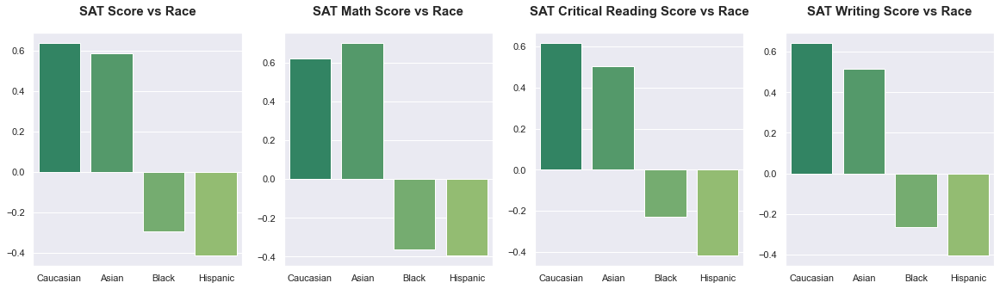

In [17]:
plt.figure(figsize = (20, 5))
combined = combined.rename(columns={'white_per':'Percentage of White Students','black_per':'Percentage of Black Students',
           'asian_per':'Percentage of Asian Students','hispanic_per':'Percentage of Hispanic Students'})

races = ['white_per','asian_per','black_per','hispanic_per']
x_ticks = ['Caucasian','Asian','Black','Hispanic']
scores = ['sat_score','SAT Math Avg. Score','SAT Critical Reading Avg. Score','SAT Writing Avg. Score']
titles = ['SAT Score','SAT Math Score','SAT Critical Reading Score','SAT Writing Score']

# loop through SAT subsections
for i in range(4):
    ax = plt.subplot(1,4,i+1)
    sns.barplot(races,correlations[scores[i]][races])
    ax.set_title(titles[i]+' vs Race', fontweight="bold", fontsize = 15, y=1.05)
    ax.set_ylabel("")
    locs, labels=plt.xticks()
    plt.xticks(locs, x_ticks) 
    
plt.show()

The corresponding correlations show us that the students in schools with the majority of White and Asian students usually perform much better on the SAT tests, while their peers from schools where Black and Hispanic students prevail are more likely to perform worse in terms of SAT scores. It is also noteworthy that according to 2012 SAT results Asians reveal greater aptitude and/or skills in mathematical reasoning, while their Caucasian peers perform better in verbal reasoning on average. At the same time, Black students also have higher scores in verbal reasoning, as compared to their Hispanic counterparts from the school-level aggregation perspective. Overall, besides socio-cultural factors, these results may probably be also affected by the fact that schools with the majority of Black and Hispanic students are usually located in poorer and less safe disticts, as well as by the lack of corresponding resources, e.g. school funding.

Let's explore in closer detail the relationship between the share of Black and Hispanic students among school students and those schools' SAT performance.

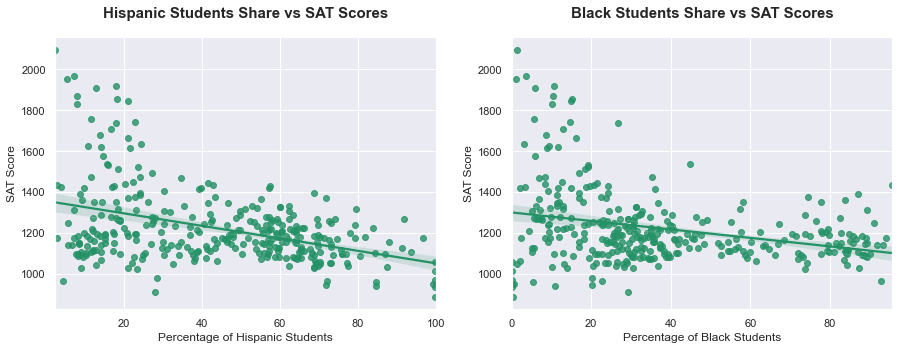

In [18]:
plt.figure(figsize = (15, 5))

ax = plt.subplot(1,2,1)
sns.regplot(combined['Percentage of Hispanic Students'],combined['SAT Score'])
ax.set_title('Hispanic Students Share vs SAT Scores', fontweight="bold", fontsize = 15, y=1.05)

ax = plt.subplot(1,2,2)
sns.regplot(combined['Percentage of Black Students'],combined['SAT Score'])
ax.set_title('Black Students Share vs SAT Scores', fontweight="bold", fontsize = 15, y=1.05)

plt.show()

In both cases we may observe that there is a significant number of schools with prevailing number of Hispanic and Black students whose SAT scores do not exceed 1400 threshold. Moreover, it is more the case for the first group of schools, than for the second. Let's consider several of them on individual basis.

In [19]:
hispanic_and_black = combined[(combined['Percentage of Black Students']>95) | (combined['Percentage of Hispanic Students']>95)]
print((hispanic_and_black[['SCHOOL NAME','SAT Score','Borough']]).to_string(index=False))

                                              SCHOOL NAME  SAT Score    Borough
                            MANHATTAN BRIDGES HIGH SCHOOL     1058.0  Manhattan
         WASHINGTON HEIGHTS EXPEDITIONARY LEARNING SCHOOL     1174.0  Manhattan
 GREGORIO LUPERON HIGH SCHOOL FOR SCIENCE AND MATHEMATICS     1014.0  Manhattan
                      ACADEMY FOR LANGUAGE AND TECHNOLOGY      951.0      Bronx
                    INTERNATIONAL SCHOOL FOR LIBERAL ARTS      934.0      Bronx
         PAN AMERICAN INTERNATIONAL HIGH SCHOOL AT MONROE      970.0      Bronx
                  MEDGAR EVERS COLLEGE PREPARATORY SCHOOL     1436.0   Brooklyn
                                MULTICULTURAL HIGH SCHOOL      887.0   Brooklyn
                   PAN AMERICAN INTERNATIONAL HIGH SCHOOL      951.0     Queens


From the list of schools above we may find out that with the exception of Medgar Evers College Preparatory School all the others do not have SAT scores over 1200. It is quite noteworthy that they are not concentrated in just one borough, but are rather dispersed over the city. Moreover, three of them are located in Manhattan, which has the most expensive neighborhoods. The majority of these schools were originally designed for immigrants, and many courses there are bilingual.

To have a more comprehensive picture let's now explore the other end of the spectrum - schools with low number of Hispanic and Black students - and inspect the respective SAT scores.

In [20]:
combined['Percentage of Caucasian and Asian'] = combined['Percentage of White Students'] + combined['Percentage of Asian Students']
non_hispanic_and_black = combined[((combined['Percentage of Hispanic Students']<10) & (combined['Percentage of Black Students']<10))]
print((non_hispanic_and_black[['SCHOOL NAME','SAT Score','Borough','Percentage of Caucasian and Asian']]).to_string(index=False))

                                     SCHOOL NAME  SAT Score        Borough  Percentage of Caucasian and Asian
                          STUYVESANT HIGH SCHOOL     2096.0      Manhattan                               95.8
 HIGH SCHOOL FOR DUAL LANGUAGE AND ASIAN STUDIES     1424.0      Manhattan                               91.8
                    BRONX HIGH SCHOOL OF SCIENCE     1969.0          Bronx                               88.9
                         TOTTENVILLE HIGH SCHOOL     1418.0  Staten Island                               87.5
             STATEN ISLAND TECHNICAL HIGH SCHOOL     1953.0  Staten Island                               93.1


Again, the considered schools are more or less dispersed over the city. Some of them are considered the best in New York with a number of famous alumni and have primarily math-related specialisations. Moreover, a few of them are qualified as magnet schools, i.e. they may draw students outside of their respective schools districts, and passing entrance exams is required to get there. Therefore, well prepared students from all over the city do primarily study in such schools. In addition, many of them are actually Asian, and only two schools located in rich Staten Island borough, have primarily white student population.

## Gender Differences Are Not Likely to Matter Much in SAT Performance

After exploring race-related differences in SAT score distribution, let's proceed further with the gender ones.

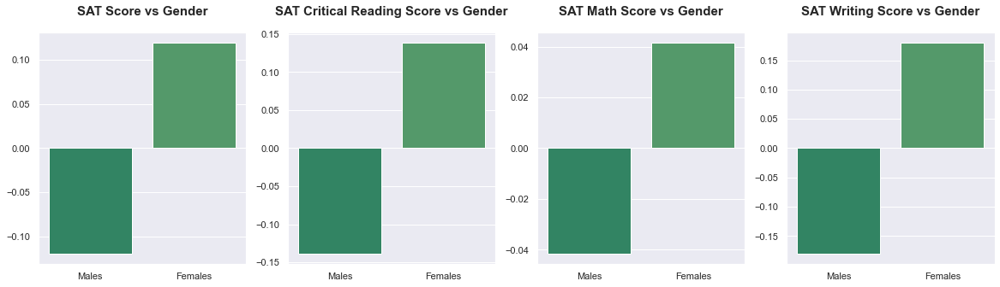

In [21]:
plt.figure(figsize = (20, 5))

combined = combined.rename(columns={'male_per':'Percentage of Males','female_per':'Percentage of Females'})

gender = ['male_per','female_per']
x_ticks = ['Males','Females']
scores = ['sat_score','SAT Critical Reading Avg. Score','SAT Math Avg. Score','SAT Writing Avg. Score']
titles = ['SAT Score','SAT Critical Reading Score','SAT Math Score','SAT Writing Score']

# loop through SAT subsections
for i in range(4):
    ax = plt.subplot(1,4,i+1)
    sns.barplot(gender,correlations[scores[i]][gender])
    ax.set_title(titles[i]+' vs Gender', fontweight="bold", fontsize = 15, y=1.05)
    ax.set_ylabel("")
    locs, labels=plt.xticks()
    plt.xticks(locs, x_ticks) 
    
plt.show()

The graphs above show us that schools where females prevail may get slightly higher SAT scores. It should not be surprising cosidering the fact that young females are generally more dilligent, as compared to their male counterparts. Nonetheless, the correlation for the overall SAT score is small to make any definitive conclusion. Similar results, though of differing magnitude, may be observed for the subsections of SAT - the most surprising one might be the SAT Math Score, where males should have conventionally performed *much* better as compared to females, because math-related domain is traditionally cosidered as male-dominated. The data show that on average this was not the case for New York high schools according to 2012 SAT results - the gender difference is negligible.

Let's further check schools with high share of studying females and high SAT scores on individual basis.

In [22]:
female = combined[(combined['Percentage of Females']>60) & (combined['SAT Score']>1600)]
print(female[['SCHOOL NAME','SAT Score','Borough']].to_string(index=False))

                                                          SCHOOL NAME  SAT Score    Borough
                                       BARD HIGH SCHOOL EARLY COLLEGE     1856.0  Manhattan
                                        ELEANOR ROOSEVELT HIGH SCHOOL     1758.0  Manhattan
                                               MILLENNIUM HIGH SCHOOL     1614.0  Manhattan
                                                   BEACON HIGH SCHOOL     1744.0  Manhattan
 FIORELLO H. LAGUARDIA HIGH SCHOOL OF MUSIC & ART AND PERFORMING ARTS     1707.0  Manhattan
                                    BARD HIGH SCHOOL EARLY COLLEGE II     1663.0     Queens
                                          TOWNSEND HARRIS HIGH SCHOOL     1910.0     Queens


Many of the considered schools are located in Manhattan and concentrate more on Liberal Arts, even though math-related subjects are also quite important in their curriculum. White students generally prevail in these schools, closely followed by Asian ones.

## Students with High SAT Scores Are Likely to Pass Additional Exams, Which Reflects Their High Motivation

Next, let's explore how the intent to go to a college or university is related to SAT scores. For that purpose we consider the share of students, who took Advacement Placement (AP) exams, in the total school enrollment. This type of exam is a subject-based program, which offers college-level curricula and examinations to high school students. American colleges and universities may grant placement and course credit to students who obtain high scores on AP exams. Therefore, it may be a good measure of the high-school students' intent to continue their studies in  post-secondary education institutions. In addition, we will also consider Regents with Advanced Designation, which are also geared primarily to high-achieving students willing to attend college afterwards.

Before embarking upon the outlined analysis, we should clean our data in order to get rid of missing values in the variables of our interest.

In [23]:
combined['ap_per'] = round(combined['AP Test Takers ']/combined['total_enrollment']*100,2)
print('Number of rows and columns before cleaning:', combined.shape)

# create data for subsequent plots
plot_data_1 = pd.DataFrame()
plot_data_1[['SAT Score','Percentage of Students Taking AP Exams','School Name',
             'Borough']] = round(combined[['SAT Score',
             'ap_per','SCHOOL NAME','Borough']],2).dropna()
print('Number of rows and columns after cleaning for AP exams:', plot_data_1.shape)

plot_data_2 = pd.DataFrame()
plot_data_2[['SAT Score','School Name','Borough',
             'Percentage of Students Taking Advanced Regent Exams']] = round(combined[['SAT Score',
             'SCHOOL NAME','Borough','Advanced Regents - % of grads']],2).dropna()
print('Number of rows and columns after cleaning for Advanced Regent exams:', plot_data_2.shape)

Number of rows and columns before cleaning: (363, 203)
Number of rows and columns after cleaning for AP exams: (204, 4)
Number of rows and columns after cleaning for Advanced Regent exams: (290, 4)


The results show us that the number of observation contracted, especially for AP exams, but that still seems enough to make conclusions, which could be generalized. 

In [24]:
fig = px.scatter(plot_data_1, trendline="ols",
    x="Percentage of Students Taking AP Exams", y="SAT Score", size="Percentage of Students Taking AP Exams", 
    color="SAT Score", size_max=23, hover_name="School Name", 
    hover_data=['Borough','Percentage of Students Taking AP Exams','SAT Score'],
    color_continuous_scale=px.colors.sequential.Viridis, title='Students Taking AP Exams vs SAT Scores')

fig.show()

Overall, the intent to go to a college, as measured by the share of AP exams takers, is definitely related to higher SAT scores. There are four leading schools in this respect with the rest significantly lagging behind. This result shows that many motivated and well-performing students are generally concentrated in a few schools, while the majority of schools are rather mediocre in their performance. It is in turn indicative of high level of inequality in secondary education, which sets the basis of even greater inequality in tertiary education.

Let's now turn to another optional exam, called Regents with Advanced Designation with respect to their relatioship to SAT scores.

In [25]:
fig = px.scatter(plot_data_2, trendline="ols",
    x="Percentage of Students Taking Advanced Regent Exams", y="SAT Score", size="Percentage of Students Taking Advanced Regent Exams", 
    color="SAT Score", size_max=23, hover_name="School Name", 
    hover_data=['Borough','Percentage of Students Taking Advanced Regent Exams','SAT Score'],
    color_continuous_scale=px.colors.sequential.Viridis, title='Students Taking Advanced Regent Exams vs SAT Scores')

fig.show()

The case of advanced regent exams is similar to the previously considered. We can observe pretty strong correlation with no outliers in the upper-left or lower-right corners - i.e. most schools with high SAT scores also have many students taking advanced regent exams. Unlike AP exams, they are less academically heavy and rather cover the same material as obligatory standardized regent examinations, but in greater depth. Henceforth, there are a higher number of schools in the upper-right corner, and the distribution is more homogenous as compared to the previous case. However, this measure also shows us significant inequalities in the secondary education - the majority of schools are located in the lower-left corner having both low SAT scores and low shares of students participating in advanced regent exams.

## Larger Class Sizes May Reflect Schools' Popularity Among Students' Parents

Let's consider further the relationship between SAT scores and average class sizes, which can be considered as an alternative measure to student-teacher ratio. Theoretically, we would expect the negative correlation between these two variables - i.e. the larger the class size, the less attention each student gets and therefore their potential performance on SAT test should be low.

In [26]:
plot_data_3 = pd.DataFrame()
plot_data_3[['SAT Score','School Name','Borough',
             'Average Class Size']] = round(combined[['SAT Score',
             'SCHOOL NAME','Borough','AVERAGE CLASS SIZE']],2).dropna()

fig = px.scatter(plot_data_3, trendline="ols",
    x="Average Class Size", y="SAT Score", size="Average Class Size", 
    color="SAT Score", size_max=15, hover_name="School Name", 
    hover_data=['Borough','Average Class Size','SAT Score'],
    color_continuous_scale=px.colors.sequential.Viridis, title='Average Class Size vs SAT Scores')

fig.show()

The results indicate that the average class size in itself doesn't explain SAT scores in the way we expected. To the contrary, there is slight positive correlation, which may be explained by the assumption that schools with the high level of academic performance may attract more students (i.e. parents are trying to send their children to such schools), while high-poverty school are generally eligible for larger funding and thus have more, but less experienced instructors. Overall, these effects might supersede that of lower student-teacher ratio.

## Drop-out Rates and School Attendance Have Predictable Relatioship to SAT Performance

Finally, let's check how attendance aggregated on the school districts level and school drop-out rates are related to SAT scores.

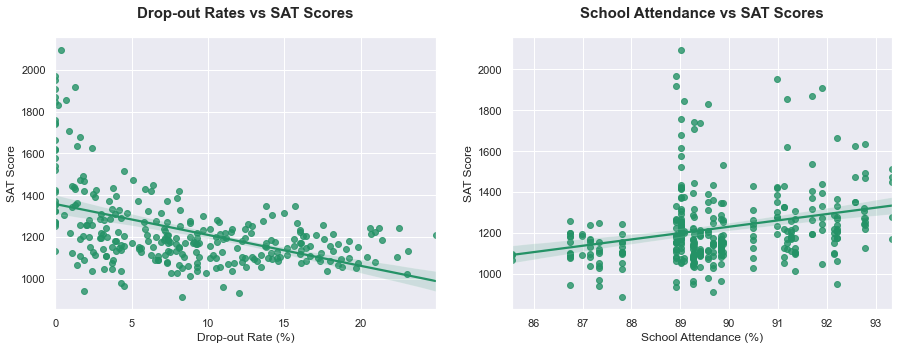

In [27]:
plt.figure(figsize = (15, 5))

ax = plt.subplot(1,2,1)
sns.regplot(combined['Dropped Out - % of cohort'],combined['SAT Score'])
ax.set_xlabel('Drop-out Rate (%)')
ax.set_ylabel('SAT Score')
ax.set_title('Drop-out Rates vs SAT Scores', fontweight="bold", fontsize = 15, y=1.05)

ax = plt.subplot(1,2,2)
sns.regplot(combined['YTD % Attendance (Avg)'],combined['SAT Score'])
ax.set_xlabel('School Attendance (%)')
ax.set_ylabel('SAT Score')
ax.set_title('School Attendance vs SAT Scores', fontweight="bold", fontsize = 15, y=1.05)

plt.show()

The more or less strong correlation between drop-out rates and SAT scores is not surprising - lower level of successful graduation in a school is indicative of its overall studying environment, where less motivated students prevail. Similarly, results concerning school attendance in its relationship to academic performance are quite expected (though blurred by the aggregation on the school district level) - the more often students attend schools on average, the higher SAT scores are revealed. 

## Socio-Cultural Factors, Language Barriers and Motivation Are of the Greatest Importance in Understanding Schools' SAT Scores Distribution

After assessing each factor of potential influence individually, we can now proceed with the overall decomposition of schools' academic performance in terms of SAT scores by these variables through regression analysis to clarify the importance of each one and make the final synthesis. Due to the fact that we have only cross-sectional data, and some of the independent variables are on the school district level, rather than school themselves, our results are not very robust to substitution with similar variables in the model specification. Moreover, without variation over time we are not able to use some advanced techniques efficiently - for example, fixed effects to account for unobserved variables and thus minimize ommited variable bias. Nonetheless, we can still get the general picture out of the information at our disposal. For that we also utilize additional data on [admission methods of high schools](https://data.cityofnewyork.us/Education/2017-Diversity-Report-Admissions-Methods/eg59-gdqu/data), provided by NYC Open Data, which shows whether high school students had to pass entrance exams to get enrolled.

In [28]:
# download data on high school admissions
admissions = pd.read_csv("https://data.cityofnewyork.us/api/views/eg59-gdqu/rows.csv?accessType=DOWNLOAD&bom=true&format=true")
admissions['Screened Admission'] = admissions['Fully Screened?'].str.contains(r'HS: Yes')*1
admissions.to_csv('Projects_data/admissions')
combined = pd.merge(combined, admissions[['DBN','Screened Admission']], on='DBN', how='left')

# create a variable scaled from 0 to 2 for schools admissions policy
combined['Openness to Students from Other Districts'] = combined['priority01'].str.contains(r'(to New York City residents)')*2 | combined['priority01'].str.contains(r'(to Bronx students)')*1 | combined['priority01'].str.contains(r'(to Queens students)')*1 | combined['priority01'].str.contains(r'(to Brooklyn students)')*1 | combined['priority01'].str.contains(r'(to Manhattan students)')*1 | combined['priority01'].str.contains(r'(to Staten Island students)')*1
combined = combined.rename(columns={'sped_percent':'Percentage of Students in Special Programs',
           'AVERAGE CLASS SIZE':'Average Class Size','ell_percent':'Percentage of English Learners'})

/Users/mac/opt/anaconda3/lib/python3.7/site-packages/pandas/core/strings.py:1954: UserWarning:

This pattern has match groups. To actually get the groups, use str.extract.



In [29]:
import sklearn
from sklearn.linear_model import LinearRegression
from statsmodels.api import OLS
import statsmodels.api as sm
from sklearn import preprocessing

# choose data for regression
data_for_reg = combined[['SAT Score','Safety and Respect Total Score','Screened Admission',
              'Adjusted Gross Income per Tax Return','Openness to Students from Other Districts',
              'Percentage of White Students','Percentage of Black Students','Percentage of Asian Students',
              'Percentage of Students in Special Programs','Percentage of Females','Total Enrollment',
              'Average Class Size','YTD % Attendance (Avg)','Percentage of English Learners',
              "Teachers' Salaries",'Percentage of Students Eligible for Free Lunch','Dropped Out - % of cohort',
              'Advanced Regents - % of grads']].dropna()

# set intercept - vector of 1 and reshape data to run regression
data_for_reg['Intercept'] = 1
x = data_for_reg.iloc[:,1:].values.reshape(-1, len(data_for_reg.columns[1:]))
y = data_for_reg.iloc[:,0].values.reshape(-1, 1)

results = sm.OLS(y,x).fit()
print(results.summary(yname='School Average SAT Score', xname=list(data_for_reg.columns[1:])))

                               OLS Regression Results                               
Dep. Variable:     School Average SAT Score   R-squared:                       0.898
Model:                                  OLS   Adj. R-squared:                  0.892
Method:                       Least Squares   F-statistic:                     140.3
Date:                      Sun, 02 Aug 2020   Prob (F-statistic):          3.82e-123
Time:                              18:40:44   Log-Likelihood:                -1592.3
No. Observations:                       288   AIC:                             3221.
Df Residuals:                           270   BIC:                             3286.
Df Model:                                17                                         
Covariance Type:                  nonrobust                                         
                                                     coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------

From the regression results above we may note that in the proposed specification gender differences, school size, average class size, attendance and drop-out rates are not significant on the 10% level. Even though the factors, captured by variables do overlap to some extent, we may still make the selection of variables for further decomposition of school average SAT scores based on their intuitive meaningfulness, the overall significance of coefficients and model fit, i.e. their close correlations with the dependent variable.

In [30]:
# chose variable of our interest for decomposition
data_for_reg_unstandardized = combined[['SAT Score','Safety and Respect Total Score','Screened Admission',
              'Adjusted Gross Income per Tax Return','Openness to Students from Other Districts',
              'Percentage of White Students','Percentage of Black Students','Percentage of Asian Students',
              'Percentage of Students in Special Programs',
              'Percentage of English Learners',
              "Teachers' Salaries",'Percentage of Students Eligible for Free Lunch',
              'Advanced Regents - % of grads']].dropna().rename(columns=({'sat_score':'SAT Score'}))


# print descriptive statistics
data_for_reg_unstandardized.describe()

,SAT Score,Safety and Respect Total Score,Screened Admission,Adjusted Gross Income per Tax Return,Openness to Students from Other Districts,Percentage of White Students,Percentage of Black Students,Percentage of Asian Students,Percentage of Students in Special Programs,Percentage of English Learners,Teachers' Salaries,Percentage of Students Eligible for Free Lunch,Advanced Regents - % of grads
count,288.000000,288.000000,288.000000,288.000000,288.000000,288.000000,288.000000,288.000000,288.000000,288.000000,288.000000,288.000000,288.000000
mean,1234.166667,7.296528,0.232639,83416.072917,1.059028,8.849306,35.825694,10.788194,14.069444,12.154861,8711.111350,65.087153,18.263194
std,191.375181,0.623010,0.423249,102613.098278,0.796325,14.520971,25.069446,15.491600,7.343335,18.143506,509.502921,16.701891,21.960610
min,913.000000,5.600000,0.000000,23500.740000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,7299.829606,15.800000,0.000000
25%,1111.750000,6.900000,0.000000,31167.550000,0.000000,1.000000,16.800000,1.400000,10.225000,2.600000,8242.436121,57.175000,2.350000
50%,1188.000000,7.300000,0.000000,44654.725000,1.000000,2.100000,30.300000,3.800000,14.700000,6.400000,8635.818795,68.700000,10.750000
75%,1279.250000,7.700000,0.000000,63213.680000,2.000000,10.225000,46.425000,12.500000,19.225000,13.325000,9057.788534,76.625000,24.200000
max,2096.000000,9.300000,1.000000,593608.480000,2.000000,82.100000,95.700000,89.500000,32.900000,91.000000,9737.431445,95.100000,99.500000


In [31]:
import plotly.graph_objects as go

# standardize all values by centering and dividing by standard deviations
data_for_reg = (data_for_reg_unstandardized-data_for_reg_unstandardized.mean())/(data_for_reg_unstandardized.std())

#data_for_reg['Intercept'] = 1
x = data_for_reg.iloc[:,1:].values.reshape(-1, len(data_for_reg.columns[1:]))
dep_var = data_for_reg.iloc[:,0].values.reshape(-1, 1)

# create array of coefficients
linear_regressor = LinearRegression() 
linear_regressor.fit(x, dep_var) 

# sort standardized values in ascending order and calculate contribution percentages
y=list(linear_regressor.coef_.flatten())
y = pd.concat([pd.DataFrame(data_for_reg.columns[1:13]),pd.DataFrame(y)],axis=1)
y.columns = ['Variable','Coefficient']
y = y.sort_values(by=['Coefficient'], ascending = True)
y_scaled = y['Coefficient']/y[y['Coefficient']>0].sum()[1]*100 # negative contributions are calculated as percentages of positive ones
y['Coefficient'] = y_scaled

# set data to display on barchart
var = ['']
plot_data = []
palette = px.colors.sequential.haline + px.colors.sequential.thermal

# loop through created list of data to make a series of barcharts
for i in range(len(y)):
    plot_data.append(go.Bar(name=y.iloc[i,0], x=var, y=[y.iloc[i,1]], marker_color=str(palette[2*i]), 
                            hovertext=y.iloc[i,0],marker_line_color='Black',marker_line_width=1,opacity=(0.7-0.3/(i+1)),))
fig = go.Figure(plot_data)

# adjust data to display
fig.update_traces(width=0.5,hovertemplate='Contribution: %{y:.2f}%')
fig.update_layout(barmode='relative', margin={"r":290,"t":30,"l":150,"b":0}, yaxis=dict(
        ticktext=['Negative contribution', '', 'Positive contribution'],tickvals=[-50, 0, 50],
        tickfont_size=14), xaxis=dict(ticktext=['Negative contributions are given as shares of the total of positive ones'],tickvals=['']),
        title="Decomposition of Schools' Average SAT Score by Factors")

# create borderline and arrows
fig.add_shape(type="line", x0=-0.5, y0=0, x1=0.5, y1=0, line=dict(color="black", width=4, dash="dot"))
fig.add_shape(type="line", x0=-0.381, y0=0, x1=-0.381, y1=75.5, line=dict(color="green", width=4))
fig.add_shape(type="line", x0=-0.381, y0=75, x1=-0.35, y1=65, line=dict(color="green", width=4))
fig.add_shape(type="line", x0=-0.381, y0=75, x1=(-0.381+0.35)-0.381, y1=65, line=dict(color="green", width=4))
fig.add_shape(type="line", x0=-0.381, y0=0, x1=-0.381, y1=-75.5, line=dict(color="grey", width=4))
fig.add_shape(type="line", x0=-0.381, y0=-75, x1=-0.35, y1=-65, line=dict(color="grey", width=4))
fig.add_shape(type="line", x0=-0.381, y0=-75, x1=(-0.381+0.35)-0.381, y1=-65, line=dict(color="grey", width=4))

fig.show()

The barchart above indicates that **overall socio-cultural factors, language barriers and motivation are of the most importance for students academic performance**, as measured by SAT scores. More precisely, the following findings can be inferred out of the regression results: 
- The factor of greatest importance in explaining school average SAT scores is the share of students who have to learn English, i.e. whose native language is not English. It might be understood as those students with a language barrier have to put more effort to overcome it, while studying the same subject as their peers. Henceforth, language barrier matters the most in academic performance of high school students according to our results. Nonetheless, its magnitude might be overstated to some extent, because many of those students are Hispanic (not included in our specification), and their SAT scores are lower due to other factors as well.
- Factors, related to the socio-cultural aspect, are quite eye-catching - family cultural background and the environment outside school play positive role in the case of Caucasian and Asian students, while it is not the case for their Black peers. The higher relative contribution of being Asian can probably be explained by the phenomenon ostensibly existent in Asian families called "tiger parenting", when children are coerced by parents to do much far beyond their standard curriculum, so that to become top-performers.
- The share of students among graduates, who are motivated to increase their chances of getting into better colleges, as measured by the respective percentages of those taking advanced regent exams, indicates that it is a significant factor, which facilitates performance on SAT. 
- The share of students enrolled in special education programs, which are usually designed for those with disabilities, controls for those with innately impaired skills. 
- The percentage of students from low income families, as measured by eligibility to free or reduced price breakfasts, indicates the impact of those with poor family background on the school average SAT scores, i.e. their accessibility to studying materials, additional classes, etc. might be constrained by the family budget. 
- The importance of teacher's salaries cannot be underestimated - usually more qualified educators earn more, which in turn might reflect higher standards and more effective methods of education. 
- High school admission screening is evidently significant - students having a better prior preparation are also able to absorb the studying material more effective and show good results on final standardized tests.
- Income effect, measured by AGI, as well as wealth effect, as measured by price per square foot in the respective location, are not as explaining the performance on SAT as the factors considered above. Therefore, it is possible to assume that only under a certain threshold the material aspect do exhibit higher relative impact on academic performance - specifically, when students cannot afford themselves the necessary studying materials, classes, etc., as reflected above by the eligibility to free and reduced price lunches. 
- Schools' openness to students from other districts within their respective bourough or even from all around New York City, as well as the perception of safety by students, teachers and parents are the least significant factors according to our decomposition. Nonetheless, their positive contribution to academic performance should also be taken into account - for instance, bullying in and outside schools often negatively affects more those, who are may be reffered as "nerds", i.e. children inclined to study more at the expense of social interactions and phyisical exercises, and who can therefore perform better on standardized tests like SAT. Schools' openness to other districts implies the possibility of drawing students, who might be motivated to study exactly in that school despite transportation costs and inconvenience.

Let's also see how our simple model with the variables chosen based on the statistical significance of their corresponding coefficients explains the actual data by plotting a scatter plot of empirical and theoretical values.

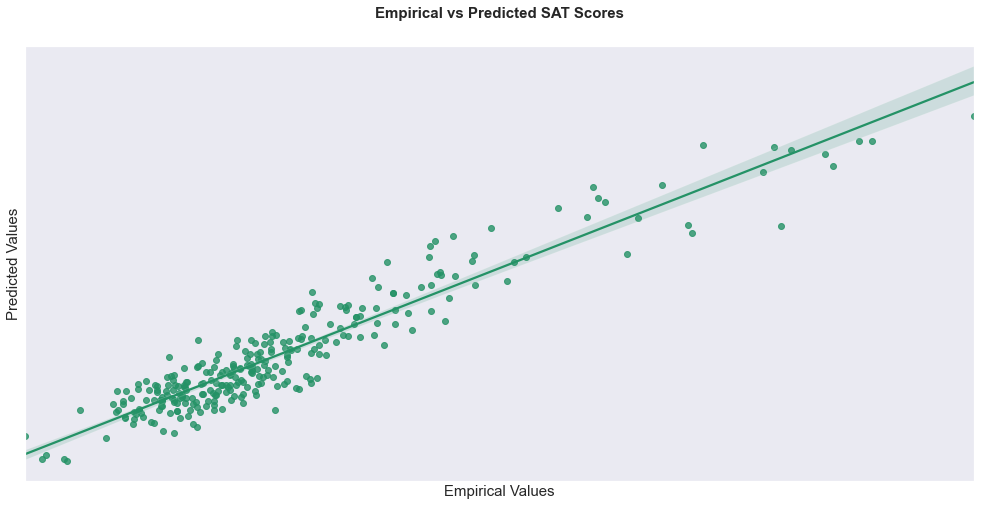

In [32]:
plt.figure(figsize = (17, 8))

dep_var_pred = linear_regressor.predict(x)
sns.regplot(dep_var, dep_var_pred)

plt.xlabel('Empirical Values', fontsize = 15)
plt.ylabel('Predicted Values', fontsize = 15)
plt.title('Empirical vs Predicted SAT Scores', fontweight="bold", fontsize = 15, y=1.05)

plt.yticks([])
plt.xticks([])
plt.show()

The results of the scatter plot show us that the proposed specification is quite suitable in terms of the coverage of variance in the empirical values. Nonetheless, the outliers, i.e. schools with exceptionally high average SAT scores, still lack some explanation, while being small in number - the increasing confidence interval of the fit line to the right reflects it clearly. Such outcomes are quite usual in these cases - the more an observation differs from the rest, the harder it is to explain it using conventional tools and/or variables.

## Conclusion

After assessing each of the factors of potential influence individually and putting them together into a single regression equation, which was decomposed afterwards, we can costruct a portrayal of a typical high school student, who is likely to be successful academically, as measured by the SAT score. Such a student is surrounded with Asian cultural environment (maybe tiger-parented), has fluent English, feels himself safe and not bullied, highly motivated to study beyond standardized high-school program, is placed in a school, where teachers are well-paid and students are rather drawn all over the city, has good basics obtained through middle school and earlier, and at the same time among his peers there are probably no that many students from poor families or those with disabilities.

As we have shown above, socio-cultural differences play a crucial role in academic performance measured by standardized tests, and this achievement gap still does exist, affecting negatively the whole society. In the case of Hispanic families it is usually explained by their **value system**, where family is placed at the first place, even at the expense of personal development - for example, the necessity of providing material support to family and early marriages detracts students from their educational process. In the case of black students, **peers' influence** may play a negative role, as described by the pejorative term "acting white", when active concentration on studies may inluence badly on the relationships with others, who are of the same socio-cultural background. The overall effect to the U.S. society and economy is detrimental - according to [McKinsey & Company estimates](https://www.mckinsey.com/industries/public-and-social-sector/our-insights/the-economic-cost-of-the-us-education-gap), if the overall academic performance of the nation were comparable to that of Korea or Finland, the additional contribution to GDP could have been between 1.3 and 2.3 trillion USD. Moreover, considering the fact that the shares of Hispanic and Black population in the total have been increasing over the years, the recurring costs are truly tremendos - **nobody wins in such a situation** over the long term period.

The same might be said about the achievement gap between students from high-income and low-income families - according to the same  McKinsey & Company report the 2008 GDP could have been 670 billion higher, were there no such gap in 1998. It is just an example, which illustrates the overall situation persistent up untill nowadays. Public policies have already been designed to mitigate it - according to some research marginal effectiveness of funding is actually higher for schools located in poorer districts, and the academic achievement gap between, for example, Black and White students was minimized when they had equal accessibility to resources. Nonetheless, their overall effect is still far from what could have been desirable and there is much to be done to make public schools' funding more targeted and efficient in alleviating disparities. Closely related to this problem is the negative relatioship between the language barrier and performance on standardized tests - many of students with non-native English are Hispanic, who don't have much resources at their disposal and at the same need to attend additional classes to master their English. Taking into account its magnitude, special attention should be paid to this factor by policy makers and those creating such tests, so that to give **equal opportunity to everyone**.

Talking about education from the generalized perspective, - as the means to manifest individuals true potential, - standardized tests, SAT included, cannot reflect students' capabilities fully, which go far beyond the ability to solve fast within a certain time frame and are rather individual in their nature. Associated researches show low correlation between SAT scores and college GPA and some universities, inluding the University of Chicago, have already stopped considering this test while reviewing applications for admission. We assert that high-level thinking abilities, i.e. its depth, is quite different from operational thinking, i.e. capacity to solve fast, and the former is far more important for the overall success in college and life in general. All in all, standardized test should not be the only factor considered in the colleges' application process, but rather be regarded just as part of a bigger picture of applicants' full potential, which is conditioned to varying extent by environmental factors, - socio-cultural and wealth related ones, - but originates from **innate abilities**. In many cases it happens **only in colleges and universities that individuals immerse deeply into the subjects of their main interest, and these innate abilities become being fully manifested**. This is why it so crucial to provide **everyone with the equal opportunity** to get the college education they want to the greater good of the whole society.